# Create figures for manuscript

#### Created by Megan Thompson-Munson (2023)

In [1]:
# Import libraries
import numpy as np
import pandas as pd
import xarray as xr
import datetime
import pickle
import glob
import geopandas
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy.interpolate import griddata
from scipy.optimize import curve_fit
from scipy import stats
import matplotlib.font_manager as font_manager
from matplotlib import mathtext
from matplotlib import gridspec
import matplotlib.colors as mplc
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.dates as mdates
from cycler import cycler
from cmcrameri import cm
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader
import matplotlib.ticker as mtick
import warnings
warnings.simplefilter('ignore', UserWarning)
warnings.filterwarnings('ignore')

# Fonts
font_files = font_manager.findSystemFonts(fontpaths=['/projects/metm9666/fonts'])
font_list = font_manager.createFontList(font_files)
font_manager.fontManager.ttflist.extend(font_list)
boldtitle = font_manager.FontProperties(fname='/projects/metm9666/fonts/Arial Bold.ttf')
italicstyle = font_manager.FontProperties(fname='/projects/metm9666/fonts/Arial Italic.ttf')
class ArialFontConstants(mathtext.FontConstantsBase):
    sup1 = 0.4
mathtext._font_constant_mapping['Arial'] = ArialFontConstants
mpl.rcParams['font.family'] = 'Arial'
mpl.rcParams['font.size'] = 9
mpl.rcParams['figure.titlesize'] = 10
# mpl.rcParams['figure.titleweight'] = 'bold'
mpl.rcParams['axes.labelsize'] = 9
mpl.rcParams['axes.titlesize'] = 9
# mpl.rcParams['axes.labelweight'] = 'bold'
mpl.rcParams['axes.linewidth'] = 0.75
mpl.rcParams['axes.facecolor'] = 'whitesmoke'
mpl.rcParams['xtick.direction'] = 'in'
mpl.rcParams['ytick.direction'] = 'in'
mpl.rcParams['xtick.major.size'] = 4
mpl.rcParams['ytick.major.size'] = 4
mpl.rcParams['xtick.major.width'] = 0.75
mpl.rcParams['ytick.major.width'] = 0.75
mpl.rcParams['mathtext.fontset'] = 'cm'
mpl.rcParams['mathtext.default'] = 'regular'
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg')

# Create colors for warming vs cooling
cmap = mpl.cm.get_cmap('RdBu')
color_cool = cmap(0.8)
color_warm = cmap(0.1)

# Set path
# path = '/scratch/alpine/metm9666/project-2_processed-output-4/'
path = '/pl/active/metm-greenland/project-2_output-processed/'

In [2]:
# Save figures?
save = 'y'

## Read in all data

In [3]:
# Smoothed FAC and smet files
fac_dec_full = xr.open_dataset(path+'FAC-DEC-smooth.nc')
fac_inc_full = xr.open_dataset(path+'FAC-INC-smooth.nc')
smet_dec_full = xr.open_dataset(path+'smet-DEC.nc')
smet_inc_full = xr.open_dataset(path+'smet-INC.nc')

# Time to percent change files
df_dec_025pct = pd.read_csv(path+'dec_025pct.csv').set_index('lat')
df_inc_025pct = pd.read_csv(path+'inc_025pct.csv').set_index('lat')
df_dec_05pct = pd.read_csv(path+'dec_05pct.csv').set_index('lat')
df_inc_05pct = pd.read_csv(path+'inc_05pct.csv').set_index('lat')
df_dec_10pct = pd.read_csv(path+'dec_10pct.csv').set_index('lat')
df_inc_10pct = pd.read_csv(path+'inc_10pct.csv').set_index('lat')

# FAC change and atm variable change
df = pd.read_csv(path+'FAC-change_vs_atm.csv')

# Shapefiles of Greenland
df_shp = geopandas.read_file(shapereader.natural_earth('50m','cultural','admin_0_countries'))
greenland = df_shp[df_shp['ADMIN']=='Greenland']['geometry'].values[0]

## Figure: Pre-pertubation characteristics across the GrIS

### Prepare data

In [4]:
# Subset for initial period and get mean and sum of surface variables
smet_initial_mean = smet_dec_full.sel(time=slice('1980','2079')).mean('time')
smet_initial_sum = smet_dec_full.sel(time=slice('1980','2079')).groupby('time.year').sum(('time')).mean('year')

# Subset for initial period and get mean of firn variables
fac_initial_mean = fac_dec_full.sel(time=slice('1980','2079')).mean('time')

# Select data (making zeros into Nans where necessary)
temperature = smet_initial_mean['temperature']
snow = smet_initial_sum['snow'].where(smet_initial_sum['snow'] > 0)
melt = smet_initial_sum['melt'].where(smet_initial_sum['snow'] > 0)
fac = fac_initial_mean['fac']

### Plot

In [5]:
# Data to plot
data = [temperature,snow,melt,fac]
cmaps = ['RdYlBu_r','PuBu','pink_r','YlGnBu']
labels = ['(a)','(b)','(c)','(d)']
cbar_labels = ['Temperature (°C)','Snowfall (mm w.e. yr$^{-1}$)','Melt (mm w.e. yr$^{-1}$)','FAC (m)']
vmins = [-30,0,0,0]
vmaxes = [-5,2500,2500,35]

# Set up figure for plotting
fig, ax = plt.subplots(figsize=(6,3.25))
fig.patch.set_facecolor('w')
gs = gridspec.GridSpec(1,4,bottom=0.1,top=1,left=0,right=1,wspace=0.01)
gsc = gridspec.GridSpec(1,4,bottom=0.06,top=0.095,left=0.025,right=0.975,wspace=0.3)

# Plot
for i in range(4):
    ax = plt.subplot(gs[i],projection=ccrs.NorthPolarStereo(central_longitude=-45))
    ax.set_extent([-56.5, -30, 59, 84], ccrs.PlateCarree())
    ax.axis('off')
    ax.fill([0,0.425,0],[0.8,1,1],c='w',zorder=5,transform=ax.transAxes)
    ax.add_geometries(greenland,crs=ccrs.PlateCarree(),facecolor='gray',edgecolor='none')
    
    plot = ax.pcolormesh(data[i].lon,data[i].lat,data[i].values,
                         cmap=cmaps[i],vmin=vmins[i],vmax=vmaxes[i],
                         zorder=10,transform=ccrs.PlateCarree())
    
    cax = plt.subplot(gsc[i])
    cax.set_frame_on(False)
    cax.get_xaxis().set_label_coords(0.5,-3.5)
    if i==0:
        cbar = plt.colorbar(plot,cax=cax,orientation='horizontal')
    if i==1:
        cbar = plt.colorbar(plot,cax=cax,orientation='horizontal',extend='max',ticks=[0,1000,2000])
    if i==2:
        cbar = plt.colorbar(plot,cax=cax,orientation='horizontal',extend='max',ticks=[0,1000,2000])
    if i==3:
        cbar = plt.colorbar(plot,cax=cax,orientation='horizontal',extend='max',ticks=[0,10,20,30])

    cbar.set_label(cbar_labels[i],va='bottom')
    cbar.ax.tick_params(direction='out')

    ax.text(0.05,0.96,labels[i],ha='left',va='top',transform=ax.transAxes,zorder=10)
    
if save=='y':
    plt.savefig('figures/figure-1.png',bbox_inches='tight',dpi=300)

## Figure: Map of change in FAC across the GrIS

### Prepare data

In [6]:
# Split FAC into initial, cooling, warming
fac_init = fac_dec_full.sel(time=slice('1980','2079'))
fac_dec = fac_dec_full.sel(time=slice('2080','2179'))
fac_inc = fac_inc_full.sel(time=slice('2080','2179'))

# Average/sum over time to find values for map plotting
init_mean = fac_init.mean('time')['fac_smooth']
final_dec = fac_dec.isel(time=-1)['fac_smooth']
final_inc = fac_inc.isel(time=-1)['fac_smooth']

# Sum over lat/lon for FAC volume for all grid cells
vol_init = fac_init.sum(('lat','lon'))['facVol']
vol_dec = fac_dec.sum(('lat','lon'))['facVol']
vol_inc = fac_inc.sum(('lat','lon'))['facVol']
vol_init_anom = vol_init - vol_init.mean()
vol_dec_anom = vol_dec - vol_dec[0]
vol_inc_anom = vol_inc - vol_inc[0]

# Calculate annual melt
melt_init_dec = smet_dec_full['melt'].sel(time='1980').sum('time')
melt_init_inc = smet_inc_full['melt'].sel(time='1980').sum('time')
melt_dec = smet_dec_full['melt'].sel(time='2179').sum('time')
melt_inc = smet_inc_full['melt'].sel(time='2179').sum('time')

# Sum over lat/lon for FAC volume for melt and non melt grid cells
vol_init_dec_melt = fac_init.where(melt_init_dec>0).sum(('lat','lon'))['facVol']
vol_init_dec_nomelt = fac_init.where(melt_init_dec==0).sum(('lat','lon'))['facVol']
vol_init_inc_melt = fac_init.where(melt_init_dec>0).sum(('lat','lon'))['facVol']
vol_init_inc_nomelt = fac_init.where(melt_init_inc==0).sum(('lat','lon'))['facVol']
vol_dec_melt = fac_dec.where(melt_dec>0).sum(('lat','lon'))['facVol']
vol_dec_nomelt = fac_dec.where(melt_dec==0).sum(('lat','lon'))['facVol']
vol_inc_melt = fac_inc.where(melt_inc>0).sum(('lat','lon'))['facVol']
vol_inc_nomelt = fac_inc.where(melt_inc==0).sum(('lat','lon'))['facVol']

# Subtract for delta
vol_dec_melt_delta = vol_dec_melt[-1] - vol_dec_melt[0]
vol_dec_nomelt_delta = vol_dec_nomelt[-1] - vol_dec_nomelt[0]
vol_inc_melt_delta = vol_inc_melt[-1] - vol_inc_melt[0]
vol_inc_nomelt_delta = vol_inc_nomelt[-1] - vol_inc_nomelt[0]

# Create time arrays
time_init = np.linspace(0,100,len(fac_init.time),endpoint=False)
time_perturb = np.linspace(100,200,len(fac_dec.time),endpoint=False)

In [7]:
wet_area = fac_init.where(melt_init_dec>0).sum(('lat','lon'))['area']
dry_area = fac_init.where(melt_init_dec==0).sum(('lat','lon'))['area']
total_area = fac_init.sum(('lat','lon'))['area']

In [8]:
dry_area/total_area

<xarray.DataArray 'area' ()>
array(0.79055539)

### Plot

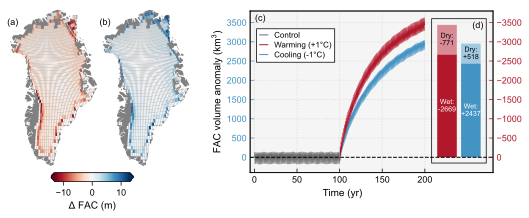

In [9]:
# Data for plotting
y0 = final_inc - init_mean
y1 = final_dec - init_mean
data = [y0,y1]
plot_labels = ['(a)','(b)','(c)','(d)']

# Set up figure for plotting
fig, ax = plt.subplots(figsize=(6.75,2.5))
fig.patch.set_facecolor('w')

# Grid for plots and colorbar
gs0 = gridspec.GridSpec(1,2,bottom=0.05,top=1,left=0,right=0.38,wspace=0)
gs1 = gridspec.GridSpec(1,1,bottom=0.05,top=0.95,left=0.5,right=1)
gsc0 = gridspec.GridSpec(1,1,bottom=0,top=0.05,left=0.09,right=0.26)

# Loop through and plot data
for i in range(2):
    
    d = data[i]
    
    ax = plt.subplot(gs0[i],projection=ccrs.NorthPolarStereo(central_longitude=-45))
    ax.set_extent([-56.5, -30, 59, 84], ccrs.PlateCarree())
    ax.add_geometries(greenland,crs=ccrs.PlateCarree(),facecolor='gray',edgecolor='none')
    ax.axis('off')
    ax.fill([0,0.425,0],[0.8,1,1],c='w',zorder=5,transform=ax.transAxes)
    
    ax.text(0,0.93,plot_labels[i],ha='left',va='top',transform=ax.transAxes,zorder=10)

    plot0 = ax.pcolormesh(d.lon,d.lat,d,
                         zorder=10,transform=ccrs.PlateCarree(),
                         cmap=cmap,vmin=-13,vmax=13)
    
cax0 = plt.subplot(gsc0[0])
cax0.set_frame_on(False)
cbar0 = plt.colorbar(plot0,cax=cax0,orientation='horizontal',extend='both')
cbar0.set_label('$\Delta$ FAC (m)',fontsize=10)
cbar0.ax.tick_params(direction='out')



# Plot time series
ax0 = plt.subplot(gs1[0])
ax0.set_ylabel('FAC volume anomaly (km$^3$)',fontsize=10,linespacing=1)
ax0.set_xlabel('Time (yr)',fontsize=10)
ax0.xaxis.set_label_coords(0.38,-0.1)
ax0.grid(c='gainsboro',ls=':',lw=1,zorder=0)
ax0.set_xticks(np.arange(0,225,50))
ax0.set_xlim((-5,280))
ax0.set_ylim((-400,3800))
ax0.tick_params(axis='y',colors=color_cool)

ax0.text(0.02,0.98,plot_labels[2],ha='left',va='top',transform=ax0.transAxes,zorder=10)

ax0.axhline(0,c='k',ls='--',lw=1,zorder=10)

ax0.plot(time_init,vol_init_anom,c='dimgray',lw=0.5,label='Control')
ax0.plot(time_perturb[0],vol_inc_anom[0],c=color_warm,lw=0.5,label='Warming (+1°C)') # For legend
ax0.plot(time_perturb,vol_dec_anom,c=color_cool,lw=0.5,label='Cooling (-1°C)')



ax0t = ax0.twinx()
ax0t.set_ylim((400,-3800))
ax0t.tick_params(axis='y',colors=color_warm)
ax0t.plot(time_perturb,vol_inc_anom,c=color_warm,lw=0.5,label='Warming (+1°C)')

# Legend
legend = ax0.legend(prop={'size':8},loc='upper left',bbox_to_anchor=[0.02,0.9],
                    handlelength=1,labelspacing=0.3,borderpad=0.1,framealpha=1)
legend.get_frame().set_edgecolor('k')
legend.get_frame().set_facecolor('w')
legend.get_frame().set_linewidth(0.75)
legend.get_frame().set_boxstyle('Square')
for legobj in legend.legendHandles:
    legobj.set_linewidth(1)
    
    
# BAR GRAPH
x = [226,254]
y_melt = [abs(vol_inc_melt_delta),vol_dec_melt_delta]
y_nomelt = [abs(vol_inc_nomelt_delta),vol_dec_nomelt_delta]
y_both = [abs(vol_inc_melt_delta)+abs(vol_inc_nomelt_delta),vol_dec_melt_delta+vol_dec_nomelt_delta]
colors = [color_warm,color_cool]

w = 23
ax0.bar(x,y_both,color='w',zorder=9,width=w) # White background
ax0.bar(x,y_melt,zorder=10,color=colors,alpha=1,width=w)
ax0.bar(x,y_nomelt,bottom=y_melt,zorder=10,color=colors,alpha=0.5,width=w)

ax0.text(x[0],y_melt[0]/2,'Wet:\n-{:.0f}'.format(float(y_melt[0])),ha='center',va='center',
         fontsize=7,zorder=20,linespacing=1.2,color='w')
ax0.text(x[1],y_melt[1]/2,'Wet:\n+{:.0f}'.format(float(y_melt[1])),ha='center',va='center',
         fontsize=7,zorder=20,linespacing=1.2,color='w')
ax0.text(x[0],(y_nomelt[0]/2)+y_melt[0],'Dry:\n-{:.0f}'.format(float(y_nomelt[0])),ha='center',va='center',
         fontsize=7,zorder=20,linespacing=1.2)
ax0.text(x[1],(y_nomelt[1]/2)+y_melt[1],'Dry:\n+{:.0f}'.format(float(y_nomelt[1])),ha='center',va='center',
         fontsize=7,zorder=20,linespacing=1.2);


ax0.add_patch(mpl.patches.Rectangle((208,-150),64,3750,facecolor='none',edgecolor='k',lw=0.75,zorder=100))
ax0.text(0.96,0.935,plot_labels[3],ha='right',va='top',transform=ax0.transAxes,zorder=10)


if save=='y':
    plt.savefig('figures/figure-2.png',bbox_inches='tight',dpi=300)

## Figure: Time to percent change

### Plot

In [10]:
# Get values for plotting
data_inc = [df_inc_025pct,df_inc_05pct,df_inc_10pct]
data_dec = [df_dec_025pct,df_dec_05pct,df_dec_10pct]

titles_inc = ['-2.5%','-5%','-10%']
titles_dec = ['+2.5%','+5%','+10%']
labels_inc = ['(a)','(b)','(c)']
labels_dec = ['(d)','(e)','(f)']

# Set up figure for plotting
fig, ax = plt.subplots(figsize=(5,4.5))
fig.patch.set_facecolor('w')
gs = gridspec.GridSpec(2,3,bottom=0,top=1,left=0.1,right=0.94,hspace=0.15,wspace=0.01)
gsc = gridspec.GridSpec(1,1,bottom=0.35,top=0.65,left=0.95,right=0.98)

# Loop through and plot data
for row in range(2):
    for col in range(3):
    
        d_inc = data_inc[col]
        d_dec = data_dec[col]

        ax = plt.subplot(gs[row,col],projection=ccrs.NorthPolarStereo(central_longitude=-45))
        ax.set_extent([-56.5, -30, 59, 84], ccrs.PlateCarree())
        ax.add_geometries(greenland,crs=ccrs.PlateCarree(),facecolor='gray',edgecolor='none')
        ax.axis('off')
        ax.fill([0,0.425,0],[0.8,1,1],c='w',zorder=5,transform=ax.transAxes)
        
        if row==0:
            ax.set_title(titles_inc[col],fontsize=9)
            ax.text(0.05,0.96,labels_inc[col],ha='left',va='top',transform=ax.transAxes,zorder=10)
            plot = ax.pcolormesh(d_inc.columns.astype('float'),d_inc.index,d_inc.values,
                                 vmin=0,vmax=100,cmap='BuPu_r',
                                 zorder=10,transform=ccrs.PlateCarree())
            if col==0:
                ax.text(-0.1,0.5,'Warming',rotation=90,ha='left',va='center',
                        fontsize=9,transform=ax.transAxes)
        if row==1:
            ax.set_title(titles_dec[col],fontsize=9)
            ax.text(0.05,0.96,labels_dec[col],ha='left',va='top',transform=ax.transAxes,zorder=10)
            plot = ax.pcolormesh(d_dec.columns.astype('float'),d_dec.index,d_dec.values,
                                 vmin=0,vmax=100,cmap='BuPu_r',
                                 zorder=10,transform=ccrs.PlateCarree())
            if col==0:
                ax.text(-0.1,0.5,'Cooling',rotation=90,ha='left',va='center',
                        fontsize=9,transform=ax.transAxes)
            
cax = plt.subplot(gsc[0])
cax.set_frame_on(False)
cbar = plt.colorbar(plot,cax=cax,extend='max',extendfrac=0.08)
cbar.set_label('Time to % change (yr)',rotation=270,labelpad=14)
cbar.ax.tick_params(direction='out')

if save=='y':
    plt.savefig('figures/figure-3.png',bbox_inches='tight',dpi=300)

## Figure: Summer temperature and melt vs FAC

### Prepare data

In [11]:
# For log plotting, add a very small number to the zero values
df[['melt_over_zero']] = df['melt'].replace(0,5e-4)

### Plot

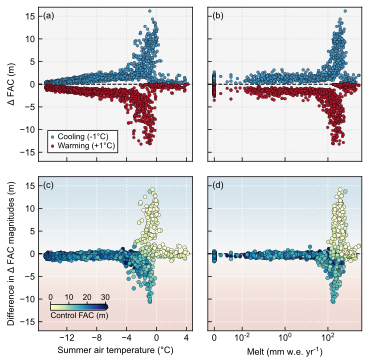

In [12]:
# Select data for plotting
x = [df['summer_temp'],df['melt_over_zero']]
y_cool = df['cool_change']
y_warm = df['warm_change']
y_diff = df['cool_warm_diff']
shading = df['fac']

# Settings
labels = [['(a)','(b)'],['(c)','(d)']]
ylabels = ['$\Delta$ FAC (m)','Difference in $\Delta$ FAC magnitudes (m)']
xlabels = ['Summer air temperature (°C)','Melt (mm w.e. yr$^{-1}$)']
xlims = [(-15.8,4.8),(2.5e-4,3800)]

# Set up figure for plotting
fig, axes = plt.subplots(2,2,figsize=(4.5,4.5))
fig.patch.set_facecolor('w')

# Loop through and plot
for row in range(2):
    for col in range(2):
        
        ax = axes[row,col]
        ax.set_xlim(xlims[col])
        ax.set_ylim((-17,17))
        ax.axhline(y=0,c='k',lw=1,ls='--')
        ax.text(0.03,0.97,labels[row][col],transform=ax.transAxes,ha='left',va='top')
        
        if col==0:
            ax.set_xticks([-12,-8,-4,0,4])
            ax.set_ylabel(ylabels[row])
        if col==1:
            ax.set_yticklabels([])
            ax.set_xscale('log')
            ax.set_xticks([5e-4,1e-2,1e0,1e2])
            ax.set_xticklabels(['0','10$^{-2}$','10$^{0}$','10$^{2}$'])
            
        
        if row==0:
            ax.scatter(x[col],y_cool,color=color_cool,ec='k',lw=0.25,s=8,zorder=4,
                       label='Cooling (-1°C)')
            ax.scatter(x[col],y_warm,color=color_warm,ec='k',lw=0.25,s=8,zorder=4,
                       label='Warming (+1°C)')
            ax.set_xticklabels([])
            ax.grid(c='gainsboro',ls=':',lw=1,zorder=0)
            
            if col==0:
                legend = ax.legend(prop={'size':8},loc='lower left',bbox_to_anchor=[0.05,0.045],
                                   handlelength=0.5,handletextpad=0.4,labelspacing=0.2,borderpad=0.05,framealpha=1)
                legend.get_frame().set_edgecolor('k')
                legend.get_frame().set_facecolor('w')
                legend.get_frame().set_linewidth(0.75)
                legend.get_frame().set_boxstyle('Square')
        
        if row==1:
            ax.imshow([[0,0],[1,1]],extent=(ax.get_xlim()[0],ax.get_xlim()[1],ax.get_ylim()[0],ax.get_ylim()[1]),
                      aspect='auto',zorder=0,cmap='RdBu_r',interpolation='bicubic',vmin=-0.3,vmax=1.3,alpha=0.2)
            ax.grid(c='w',ls=':',lw=1,zorder=1)
            ax.set_xlabel(xlabels[col])
            
            fac_plot = ax.scatter(x[col],y_diff,c=shading,
                                  cmap='YlGnBu',vmin=0,vmax=30,ec='k',lw=0.25,s=15,zorder=4)
            if col==0:
                cax = inset_axes(ax,width=0.8,height=0.08,loc='upper left',
                         bbox_to_anchor=[0.05,0.2],bbox_transform=ax.transAxes) 
                cbar = plt.colorbar(fac_plot,cax=cax,orientation='horizontal',ticks=[0,10,20,30],extend='max')
                cbar.set_label('Control FAC (m)',fontweight='normal',fontsize=8,labelpad=2)
                cax.xaxis.set_ticks_position('top')
                cbar.ax.tick_params(direction='out',length=3,width=0.75,labelsize=8,pad=0)
                cbar.outline.set_linewidth(0.75)  

plt.subplots_adjust(left=0,right=1,bottom=0,top=1,wspace=0.1,hspace=0.1)

if save=='y':
    plt.savefig('figures/figure-4.png',bbox_inches='tight',dpi=300)

## Figure: Summer air temperature vs melt and firn temperature

In [13]:
# Sort values for plotting and add in value for zero-melt
df_sort_by_warm = df.sort_values(by=['warm_change'],ascending=False)
df_sort_by_warm[['melt_over_zero']] = df_sort_by_warm['melt'].replace(0,5e-4)

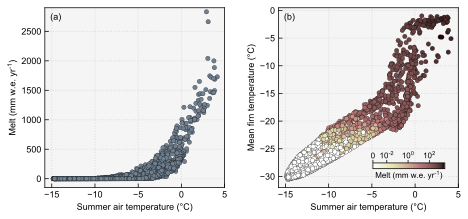

In [14]:
# Set up figure for plotting
fig, axes = plt.subplots(figsize=(5.75,2.5))
fig.patch.set_facecolor('w')

labels = ['(a)','(b)']

gs0 = gridspec.GridSpec(1,2,left=0,right=1,bottom=0,top=1)

ax0 = plt.subplot(gs0[0])
ax0.grid(c='gainsboro',ls=':',lw=1,zorder=0)
ax0.set_xlabel('Summer air temperature ($\degree$C)')
ax0.set_xlim((-15.8,5))
ax0.set_ylim((-150,2900))
ax0.set_ylabel('Melt (mm w.e. yr$^{-1}$)')
ax0.text(0.03,0.97,labels[0],transform=ax0.transAxes,ha='left',va='top')

ax0.scatter(df_sort_by_warm['summer_temp'],df_sort_by_warm['melt'],
            c='slategray',ec='k',lw=0.25,s=20,zorder=10)
# ax0.plot(x,yfit,c='k',lw=1,zorder=1000)


ax1 = plt.subplot(gs0[1])
ax1.grid(c='gainsboro',ls=':',lw=1,zorder=0)
ax1.set_xlabel('Summer air temperature ($\degree$C)')
ax1.set_xlim((-15.8,5))
ax1.set_ylabel('Mean firn temperature (°C)')
ax1.text(0.03,0.97,labels[1],transform=ax1.transAxes,ha='left',va='top')

melt_plot = ax1.scatter(df_sort_by_warm['summer_temp'],df_sort_by_warm['firn_temp'],
                   c=df_sort_by_warm['melt_over_zero'],norm=mpl.colors.LogNorm(),cmap='pink_r',
                   ec='k',lw=0.25,s=20,zorder=10)

cax = inset_axes(ax1,width=1,height=0.08,loc='lower right',
                 bbox_to_anchor=[0.95,0.08],bbox_transform=ax1.transAxes) 
cbar = plt.colorbar(melt_plot,cax=cax,orientation='horizontal',ticks=[5e-4,1e-2,1e0,1e2])
cbar.set_label('Melt (mm w.e. yr$^{-1}$)',fontweight='normal',fontsize=8,labelpad=2)
cax.xaxis.set_ticks_position('top')
cbar.ax.tick_params(direction='out',length=3,width=0.75,labelsize=8,pad=0)
cbar.ax.set_xticklabels(['0','10$^{-2}$','10$^{0}$','10$^{2}$'])
cbar.outline.set_linewidth(0.75)  

plt.subplots_adjust(left=0,right=1,bottom=0,top=1,wspace=0.3,hspace=0.1)

if save=='y':
    plt.savefig('figures/figure-5.png',bbox_inches='tight',dpi=300)

## Figure: Snowfall vs FAC

### Prepare data

In [15]:
# For log plotting, add a very small number to the zero values
df[['rain_over_zero']] = df['rain'].replace(0,2e-2)

### Plot

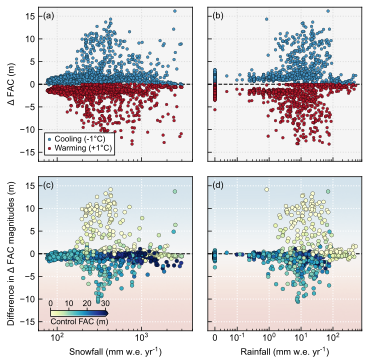

In [16]:
# Select data for plotting
x = [df['snow'],df['rain_over_zero']]
y_cool = df['cool_change']
y_warm = df['warm_change']
y_diff = df['cool_warm_diff']
shading = df['fac']

# Settings
labels = [['(a)','(b)'],['(c)','(d)']]
ylabels = ['$\Delta$ FAC (m)','Difference in $\Delta$ FAC magnitudes (m)']
xlabels = ['Snowfall (mm w.e. yr$^{-1}$)','Rainfall (mm w.e. yr$^{-1}$)']
xlims = [(6e1,4e3),(1.2e-2,8e2)]

# Set up figure for plotting
fig, axes = plt.subplots(2,2,figsize=(4.5,4.5))
fig.patch.set_facecolor('w')

# Loop through and plot
for row in range(2):
    for col in range(2):
        
        ax = axes[row,col]
        ax.set_xlim(xlims[col])
        ax.set_ylim((-17,17))
        ax.axhline(y=0,c='k',lw=1,ls='--')
        ax.text(0.03,0.97,labels[row][col],transform=ax.transAxes,ha='left',va='top')
        ax.set_xscale('log')
        
        if col==0:
            ax.set_ylabel(ylabels[row])
        if col==1:
            ax.set_yticklabels([])
            ax.set_xticks([2e-2,1e-1,1e0,1e1,1e2])
            ax.set_xticklabels(['0','10$^{-1}$','10$^{0}$','10$^{1}$','10$^{2}$'])            
        
        if row==0:
            ax.scatter(x[col],y_cool,color=color_cool,ec='k',lw=0.25,s=8,zorder=4,
                       label='Cooling (-1°C)')
            ax.scatter(x[col],y_warm,color=color_warm,ec='k',lw=0.25,s=8,zorder=4,
                       label='Warming (+1°C)')
            ax.set_xticklabels([])
            ax.grid(c='gainsboro',ls=':',lw=1,zorder=0)
            
            if col==0:
                legend = ax.legend(prop={'size':8},loc='lower left',bbox_to_anchor=[0.03,0.03],
                                   handlelength=0.5,handletextpad=0.4,labelspacing=0.2,borderpad=0.05,framealpha=1)
                legend.get_frame().set_edgecolor('k')
                legend.get_frame().set_facecolor('w')
                legend.get_frame().set_linewidth(0.75)
                legend.get_frame().set_boxstyle('Square')
        
        if row==1:
            ax.imshow([[0,0],[1,1]],extent=(ax.get_xlim()[0],ax.get_xlim()[1],ax.get_ylim()[0],ax.get_ylim()[1]),
                      aspect='auto',zorder=0,cmap='RdBu_r',interpolation='bicubic',vmin=-0.3,vmax=1.3,alpha=0.2)
            ax.grid(c='w',ls=':',lw=1,zorder=1)
            ax.set_xlabel(xlabels[col])
            
            fac_plot = ax.scatter(x[col],y_diff,c=shading,
                                  cmap='YlGnBu',vmin=0,vmax=30,ec='k',lw=0.25,s=15,zorder=4)
            if col==0:
                cax = inset_axes(ax,width=0.8,height=0.08,loc='upper left',
                         bbox_to_anchor=[0.05,0.16],bbox_transform=ax.transAxes) 
                cbar = plt.colorbar(fac_plot,cax=cax,orientation='horizontal',ticks=[0,10,20,30],extend='max')
                cbar.set_label('Control FAC (m)',fontweight='normal',fontsize=8,labelpad=2)
                cax.xaxis.set_ticks_position('top')
                cbar.ax.tick_params(direction='out',length=3,width=0.75,labelsize=8,pad=0)
                cbar.outline.set_linewidth(0.75)  

plt.subplots_adjust(left=0,right=1,bottom=0,top=1,wspace=0.1,hspace=0.1)

if save=='y':
    plt.savefig('figures/figure-6.png',bbox_inches='tight',dpi=300)

## Figure: Example time series of FAC

### Prepare data

In [17]:
# Firn data from .pro files
f = [1763,97,232,683,859,1718]
pickle_files = [path+'pro-files_processed/{}_firn-data.p'.format(i) for i in f]

# Load all
firn_data = [pickle.load(open(i,'rb')) for i in pickle_files]
firn_data = np.array(firn_data).reshape((2,3))

# # Get datafraome of atmospheric values from the desired files
df_eg = df[df['idx'].isin(f)]
df_eg = df_eg.sort_values(by='summer_temp')

### Plot data

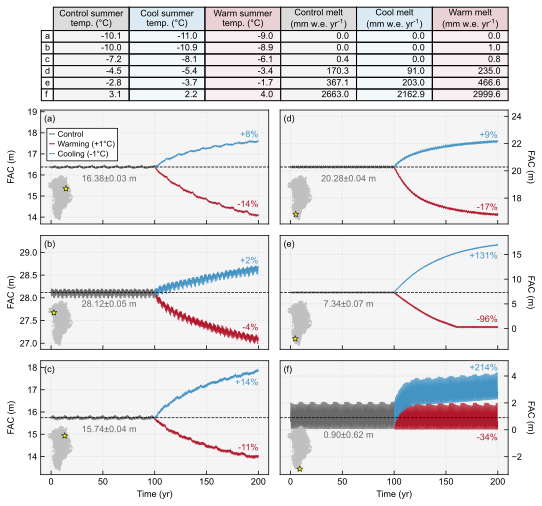

In [18]:
# Set up figure for plotting
fig, ax = plt.subplots(figsize=(6.5,6.5))
fig.patch.set_facecolor('w')

# Create grid for plotting
gs = gridspec.GridSpec(3,2,bottom=0,top=0.78,left=0,right=1,wspace=0.05,hspace=0.1)
gs_table = gridspec.GridSpec(1,1,bottom=0.8,top=1,left=0,right=1)

# Labels and data for plotting
labels = [['(a)','(b)','(c)'],['(d)','(e)','(f)']]
dec_deltas = []
inc_deltas = []
dec_f = [[18.1,28.9,17.5],[22.9,15.5,4.9]]
inc_f = [[14.4,27.25,14.2],[17,1,-0.9]]

# Loop through grid for plotting time series
for col in range(2):
    for row in range(3):
        
        d = firn_data[col,row]
        
        ax = plt.subplot(gs[row,col])
    
        # Set up axes
        ax.grid(c='gainsboro',ls=':',lw=1,zorder=0)
        ax.text(0.015,0.9,labels[col][row],transform=ax.transAxes)
        
        # Calculate mean and plot horizontal line
        mean = np.mean(d['initial']['fac'])
        std = np.std(d['initial']['fac'])
        ax.axhline(mean,c='k',ls='--',lw=0.75,zorder=3)
    
        # Calculate custom y lim so it's symmetric
        dec_delta = d['dec']['fac'][-1] - mean
        inc_delta = mean - d['inc']['fac'][-1]
        dec_deltas.append(dec_delta/mean)
        inc_deltas.append(inc_delta/mean)
        max_delta = max(inc_delta,dec_delta)*1.2
        ax.set_ylim((mean-max_delta,mean+max_delta))
        if (col==1)&(row==2):
            max_delta = max(inc_delta,dec_delta)*2.2
            ax.set_ylim((mean-max_delta,mean+max_delta))
    
        # Put y-labels on outside
        if col==1:
            ax.yaxis.tick_right()
            ax.yaxis.set_label_position('right')
            ax.set_ylabel('FAC (m)',rotation=270,va='bottom')
            ax.get_yaxis().set_label_coords(1.08,0.5)
        else:
            ax.set_ylabel('FAC (m)',va='bottom')
            ax.get_yaxis().set_label_coords(-0.11,0.5)
        if row!=2:
            ax.set_xticklabels([])
        else:
            ax.set_xlabel('Time (yr)')
                         
        # Plot data
        ax.plot(d['initial']['years'],d['initial']['fac'],
                   c='dimgray',lw=0.75,label='Control')
        ax.plot(d['inc']['years'],d['inc']['fac'],
                   c=color_warm,lw=0.75,label='Warming (+1°C)')
        ax.plot(d['dec']['years'],d['dec']['fac'],
                   c=color_cool,lw=0.75,label='Cooling (-1°C)')

        # Legend
        if (row==0)&(col==0):
            legend = ax.legend(prop={'size':8},loc='lower left',bbox_to_anchor=[0.02,0.54],
                               handlelength=0.6,labelspacing=0.3,borderpad=0.04,handletextpad=0.4,framealpha=1)
            legend.get_frame().set_edgecolor('k')
            legend.get_frame().set_linewidth(0.75)
            legend.get_frame().set_facecolor('w')
            legend.get_frame().set_boxstyle('Square')
            for legobj in legend.legendHandles:
                legobj.set_linewidth(1)
        
        # Show percent change on plot
        ax.text(200,dec_f[col][row],'+{:.0%}'.format(dec_delta/mean),ha='right',va='top',c=color_cool,fontsize=9)
        ax.text(200,inc_f[col][row],'-{:.0%}'.format(inc_delta/mean),ha='right',va='bottom',c=color_warm,fontsize=9)
        if (row==2)&(col==1):
            ax.text(0.3,0.38,'{:.2f}±{:.2f} m'.format(mean,std),ha='center',va='top',c='dimgray',fontsize=9,transform=ax.transAxes)
        else:
            ax.text(0.3,0.43,'{:.2f}±{:.2f} m'.format(mean,std),ha='center',va='top',c='dimgray',fontsize=9,transform=ax.transAxes)
        
        # Add a locator map
        ax_map = inset_axes(ax,width=0.45,height=0.65,bbox_to_anchor=(0.015,0.025),loc='lower left',
                            borderpad=0,bbox_transform=ax.transAxes,axes_class=cartopy.mpl.geoaxes.GeoAxes, 
                            axes_kwargs=dict(map_projection=ccrs.NorthPolarStereo(central_longitude=-45)))
        ax_map.set_facecolor('w')
        ax_map.set_extent([-56.5,-30,59,84],ccrs.PlateCarree())
        ax_map.axis('off')
        ax_map.add_geometries(greenland,crs=ccrs.PlateCarree(),facecolor='silver',edgecolor='none')

        # Plot a star where the MERRA-2 location is
        ax_map.scatter(d['lon'],d['lat'],transform=ccrs.PlateCarree(),
                       color='yellow',s=40,ec='k',lw=0.5,marker='*',zorder=2)

# Plot table
ax_table = plt.subplot(gs_table[0])
ax_table.axis('off')
t_columns = ['Control summer\ntemp. (°C)','Cool summer\ntemp. (°C)','Warm summer\ntemp. (°C)',
             'Control melt\n(mm w.e. yr$^{-1}$)','Cool melt\n(mm w.e. yr$^{-1}$)','Warm melt\n(mm w.e. yr$^{-1}$)']
t_index = [' a ',' b ',' c ',' d ',' e ',' f ']
t_data = df_eg[['summer_temp','summer_temp_cool','summer_temp_warm',
                'melt','melt_cool','melt_warm']].round(1).values
t_colors = np.tile(np.array(['whitesmoke','#4393c310','#8a0b2510']),(6,2))
t_colors_col = np.tile(np.array(['gainsboro','#4393c330','#8a0b2530']),(1,2)).tolist()[0]

the_table = ax_table.table(cellText=t_data,rowLabels=t_index,colLabels=t_columns,
                           bbox=[0.027,0,1-0.027,1],colColours=t_colors_col,cellColours=t_colors)
the_table.auto_set_font_size(False)
the_table.set_fontsize(9)

cellDict = the_table.get_celld()
for i in range(0,len(t_columns)):
    cellDict[(0,i)].set_height(0.18)
    for j in range(1,len(t_data)+1):
        cellDict[(j,i)].set_height(0.09)
        cellDict[(j,-1)].set_height(0.09)

if save=='y':
    plt.savefig('figures/figure-7.png',bbox_inches='tight',dpi=300)

## Figure: Example time-depth plot

### Prepare data

In [19]:
# Firn data from .pro files
f = [1763,97,232,683,859,1718]
pickle_files = [path+'pro-files_processed/{}_firn-data-interpolated.p'.format(i) for i in f]

# Load all
firn_data = [pickle.load(open(i,'rb')) for i in pickle_files]

In [20]:
# Select one
data_file_4 = firn_data[4]

# Organize for plotting
data_4 = [[data_file_4['rho_dec'],data_file_4['temp_dec'],data_file_4['lwc_dec']*100],
          [data_file_4['rho_inc'],data_file_4['temp_inc'],data_file_4['lwc_inc']*100]]


# Select another
data_file_5 = firn_data[5]

# Organize for plotting
data_5 = [[data_file_5['rho_dec'],data_file_5['temp_dec'],data_file_5['lwc_dec']*100],
          [data_file_5['rho_inc'],data_file_5['temp_inc'],data_file_5['lwc_inc']*100]]

### Plot

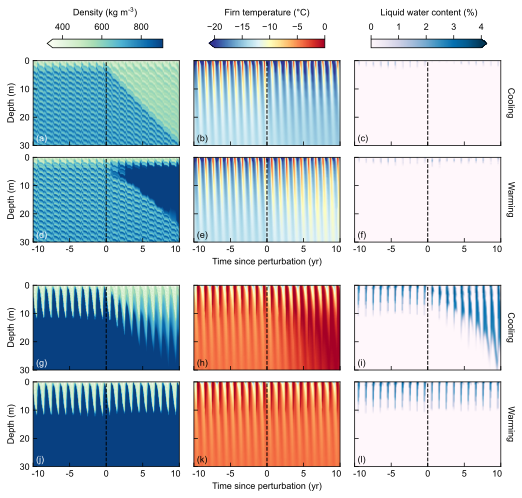

In [21]:
# Create subplot parameters
cmaps = ['GnBu','RdYlBu_r','PuBu']
vmins = [350,-20,0]
vmaxes = [910,0,4]
cbar_labels = ['Density (kg m$^{-3}$)','Firn temperature (°C)','Liquid water content (%)']
plot_labels_top = np.array([['(a)','(b)','(c)'],['(d)','(e)','(f)']])
plot_labels_bot = np.array([['(g)','(h)','(i)'],['(j)','(k)','(l)']])
scenario = ['Cooling','Warming']

# Set up figure and gridspec for plotting
fig = plt.figure(figsize=(6.5,6))
fig.patch.set_facecolor('w')
grid_cbar = gridspec.GridSpec(1,3,bottom=0.97,top=0.99,left=0.03,right=0.97,wspace=0.4)
grid_top = gridspec.GridSpec(2,3,bottom=0.52,top=0.94,left=0,right=1,hspace=0.14,wspace=0.1)
grid_bot = gridspec.GridSpec(2,3,bottom=0,top=0.42,left=0,right=1,hspace=0.14,wspace=0.1)

for col in range(3):
    for row in range(2):
    
        # Select data and calculate extent
        d = data_4[row][col]
        x = d.columns-100
        y = d.index
        extent = np.min(x),np.max(x),np.max(y),np.min(y)

        # Create axis for plotting and customize
        ax = fig.add_subplot(grid_top[row,col])
        ax.set_xlim((-10,10))
        ax.set_ylim((30,0))
        ax.axvline(x=0,c='k',ls='--',lw=1)
        if col>0:
            ax.text(0.02,0.05,plot_labels_top[row][col],transform=ax.transAxes)
        else:
            ax.text(0.02,0.05,plot_labels_top[row][col],transform=ax.transAxes,c='w')
    
        # Plot data
        plot = ax.imshow(d,extent=extent,origin='lower',aspect='auto',
                         cmap=cmaps[col],vmin=vmins[col],vmax=vmaxes[col])

        # Customize subplots
        if row==0:
            ax.set_xticklabels([])
        if row==1:
            ax.set_xticklabels(['    -10','-5','0','5','10   '])
        if (row==1)&(col==1):
            ax.set_xlabel('Time since perturbation (yr)')
        if col==0:
            ax.set_ylabel('Depth (m)')
        if col>0:
            ax.set_yticklabels([])
        if col==2:
            ax.set_ylabel(scenario[row],rotation=270,labelpad=14)
            ax.yaxis.set_label_position('right')        
    
    cax = plt.subplot(grid_cbar[col])
    cax.set_frame_on(False)
    if col!=2:
        cbar = plt.colorbar(plot,cax=cax,orientation='horizontal',extend='min')
    else:
        cbar = plt.colorbar(plot,cax=cax,orientation='horizontal',extend='max')
    cbar.ax.tick_params(direction='out')
    cbar.ax.xaxis.set_ticks_position('top')
    cbar.ax.xaxis.set_label_position('top')
    cbar.set_label(cbar_labels[col],labelpad=8)
    
for col in range(3):
    for row in range(2):
    
        # Select data and calculate extent
        d = data_5[row][col]
        x = d.columns-100
        y = d.index
        extent = np.min(x),np.max(x),np.max(y),np.min(y)

        # Create axis for plotting and customize
        ax = fig.add_subplot(grid_bot[row,col])
        ax.set_xlim((-10,10))
        ax.set_ylim((30,0))
        ax.axvline(x=0,c='k',ls='--',lw=1)
        if col>0:
            ax.text(0.02,0.05,plot_labels_bot[row][col],transform=ax.transAxes)
        else:
            ax.text(0.02,0.05,plot_labels_bot[row][col],transform=ax.transAxes,c='w')
    
        # Plot data
        plot = ax.imshow(d,extent=extent,origin='lower',aspect='auto',
                         cmap=cmaps[col],vmin=vmins[col],vmax=vmaxes[col])

        # Customize subplots
        if row==0:
            ax.set_xticklabels([])
        if row==1:
            ax.set_xticklabels(['    -10','-5','0','5','10   '])
        if (row==1)&(col==1):
            ax.set_xlabel('Time since perturbation (yr)')
        if col==0:
            ax.set_ylabel('Depth (m)')
        if col>0:
            ax.set_yticklabels([])
        if col==2:
            ax.set_ylabel(scenario[row],rotation=270,labelpad=14)
            ax.yaxis.set_label_position('right')

if save=='y':
    plt.savefig('figures/figure-8.png',bbox_inches='tight',dpi=300)

## Figure: FAC response types

### Prepare data

In [22]:
df.columns

Index(['lat', 'lon', 'idx', 'fac', 'fac_cool', 'fac_warm', 'summer_temp',
       'summer_temp_cool', 'summer_temp_warm', 'melt', 'melt_cool',
       'melt_warm', 'snow', 'snow_cool', 'snow_warm', 'rain', 'rain_cool',
       'rain_warm', 'firn_temp', 'firn_temp_cool', 'firn_temp_warm', 'area',
       'ltsr', 'cool_change', 'warm_change', 'cool_perchange',
       'warm_perchange', 'cool_warm_diff', 'cool_warm_perdiff', 'category',
       'category_5per', 'melt_over_zero', 'rain_over_zero'],
      dtype='object')

In [23]:
# Pivot for map plotting
df_2d = df.pivot(index='lat',columns='lon',values='category_5per')
df_2d_diff = df.pivot(index='lat',columns='lon',values='cool_warm_diff')

### Plot

In [24]:
# Select plotting variables
x = df.fac
y0 = df.cool_change
y1 = df.warm_change
y2 = df.cool_warm_diff

labels = ['(a)','(b)','(c)','(d)']

# Color for FAC-limited
color_limited='#c7ffc7'

# Set up figure for plotting
fig, axes = plt.subplots(figsize=(6.5,3.5))
fig.patch.set_facecolor('w')
gs0 = gridspec.GridSpec(2,1,left=0,right=0.45,bottom=0,top=1,hspace=0.15)
gs1 = gridspec.GridSpec(1,2,left=0.48,right=1,bottom=0.2,top=1,wspace=0)

# Customize both axes together
for i in range(2):
    ax = plt.subplot(gs0[i])
    ax.set_xlim((-2,42))
    ax.set_ylim((-18,18))
    ax.text(0.01,0.03,labels[i],ha='left',va='bottom',transform=ax.transAxes,zorder=10)
    
# Plot percent change
ax0 = plt.subplot(gs0[0])
ax0.grid(c='gainsboro',ls=':',lw=1,zorder=0)
ax0.set_ylabel('$\Delta$ FAC (m)')
ax0.axhline(0,lw=1,ls=':',c='k',zorder=2)

ax0.vlines(x,y1,y0,
           color='darkgray',lw=0.5,zorder=3)

ax0.scatter(x,y0,
            color=color_cool,ec='k',lw=0.5,s=10,marker='s',zorder=4,
            label='Cooling (-1°C)')
ax0.scatter(x,y1,
            color=color_warm,ec='k',lw=0.5,s=10,marker='s',zorder=4,
            label='Warming (+1°C)')


legend = ax0.legend(prop={'size':8},loc='upper right',bbox_to_anchor=[0.98,0.97],
                   handlelength=1,labelspacing=0.3,borderpad=0.1,framealpha=1)
legend.get_frame().set_edgecolor('k')
legend.get_frame().set_linewidth(1)
legend.get_frame().set_boxstyle('Square')
for legobj in legend.legendHandles:
    legobj.set_linewidth(1)

# Plot response ratio
ax1 = plt.subplot(gs0[1])
ax1.grid(c='w',ls=':',lw=1,zorder=0)
ax1.set_ylabel('Difference in $\Delta$ FAC\nmagnitudes (m)')
ax1.set_xlabel('Control FAC (m)')
ax1.axhline(0,lw=1,ls=':',c='k')

# Shade areas above and below 0
ax1.imshow([[0,0],[1,1]],extent=(ax1.get_xlim()[0],ax1.get_xlim()[1],ax1.get_ylim()[0],ax1.get_ylim()[1]),
           aspect='auto',zorder=0,cmap='RdBu_r',interpolation='bicubic',vmin=-0.3,vmax=1.3,alpha=0.2)

ax1.scatter(x[df.category_5per==0],y2[df.category_5per==0],
            color='w',ec='k',lw=0.5,s=15,marker='s',zorder=5,
            label='Equal response')
ax1.scatter(x[df.category_5per==1],y2[df.category_5per==1],
            color=color_limited,ec='k',lw=0.5,s=10,marker='D',zorder=4,
            label='FAC-limited response')
ax1.scatter(x[df.category_5per==2],y2[df.category_5per==2],
            color=color_cool,ec='k',lw=0.5,s=28,marker='P',zorder=4,
            label='Greater response to cooling')
ax1.scatter(x[df.category_5per==3],y2[df.category_5per==3],
            color=color_warm,ec='k',lw=0.5,s=15,marker='o',zorder=4,
            label='Greater response to warming')

legend1 = ax1.legend(prop={'size':8},loc='lower left',bbox_to_anchor=[1.05,0],
                   handlelength=1,labelspacing=0.3,borderpad=0.1,framealpha=1)
legend1.get_frame().set_edgecolor('k')
legend1.get_frame().set_linewidth(1)
legend1.get_frame().set_boxstyle('Square')


for i in range(2):
    ax2 = plt.subplot(gs1[i],projection=ccrs.NorthPolarStereo(central_longitude=-45))
    ax2.set_extent([-56.5, -30, 59, 84], ccrs.PlateCarree())
    ax2.add_geometries(greenland,crs=ccrs.PlateCarree(),facecolor='dimgray',edgecolor='none')
    ax2.axis('off')
    ax2.fill([0,0.425,0],[0.8,1,1],c='w',zorder=5,transform=ax2.transAxes)
    ax2.text(0.05,0.96,labels[i+2],ha='left',va='top',transform=ax2.transAxes,zorder=10)

    cmap_discrete = mplc.ListedColormap(['w',color_limited,color_cool,color_warm])

    if i==0:
        ax2.pcolormesh(df_2d.columns-(0.625/2),df_2d.index-(0.5/2),df_2d.values,
                       cmap=cmap_discrete,
                       transform=ccrs.PlateCarree(),zorder=10)
    if i==1:
        plot = ax2.pcolormesh(df_2d_diff.columns-(0.625/2),df_2d_diff.index-(0.5/2),df_2d_diff.values,
                              cmap=cmap,vmin=-10,vmax=10,
                              transform=ccrs.PlateCarree(),zorder=10)

gsc0 = gridspec.GridSpec(1,1,left=0.77,right=0.96,bottom=0.145,top=0.18)
cax0 = plt.subplot(gsc0[0])
cax0.set_frame_on(False)
cbar0 = plt.colorbar(plot,cax=cax0,orientation='horizontal',extend='both')
cbar0.set_label('Difference in $\Delta$ FAC\nmagnitudes (m)',fontsize=10,linespacing=1)
cbar0.ax.tick_params(direction='out')

if save=='y':
    plt.savefig('figures/figure-9.png',bbox_inches='tight',dpi=300)

In [25]:
df['category_5per'].value_counts()

0    1282
3     235
1     185
2      22
Name: category_5per, dtype: int64

## Supplemental figure: Example forcing

In [26]:
# files = glob.glob('/scratch/alpine/metm9666/project-2_smet-generated-4/69.500_-27.500_*.smet')
files = glob.glob('/pl/active/metm-greenland/project-2_smet-generated/69.500_-27.500_*.smet')

def read_smet(file):

    # Column names
    names = ['timestamp','TA','QI','U','V','ISWR','ILWR','PSUM','PSUM_PH']

    # Read data, skip header rows, and only grab one year
    df = pd.read_table(file,skiprows=96448,header=None,delim_whitespace=True,names=names,nrows=8760) 

    # Convert time to timestamp and set as index
    df['time'] = pd.to_datetime(df.timestamp)
    df = df.set_index('time')
    
    return df 

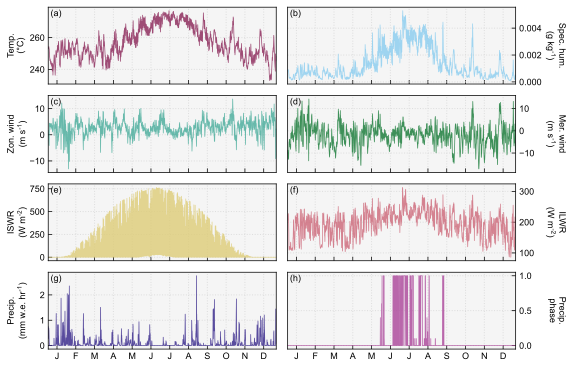

In [27]:
smet = read_smet(files[0])

# Data-specific parameters
ylabels = ['Temp.\n(°C)','Spec. hum.\n(g kg$^{-1}$)','Zon. wind\n(m s$^{-1}$)',
           'Mer. wind\n(m s$^{-1}$)','ISWR\n(W m$^{-2}$)','ILWR\n(W m$^{-2}$)',
           'Precip.\n(mm w.e. hr$^{-1}$)','Precip.\nphase']
colors = ['#882255','#88ccee','#44aa99','#117733','#ddcc77','#cc6677','#332288','#aa4499']
labels = ['(a)','(b)','(c)','(d)','(e)','(f)','(g)','(h)']

# Set up figure for plotting
fig, axes = plt.subplots(4,2,figsize=(6.5,4.75))
fig.patch.set_facecolor('w')
axes = axes.flatten()

for i in range(len(smet.columns)-1):
    ax = axes[i]
    ax.grid(c='gainsboro',ls=':',lw=1,zorder=0)
    ax.set_xlim((pd.to_datetime('1991-01-01'),pd.to_datetime('1991-12-31')))
    
    
    if i%2:
        ax.yaxis.tick_right()
        ax.yaxis.set_label_position('right')
        ax.set_ylabel(ylabels[i],rotation=270)
        ax.get_yaxis().set_label_coords(1.22,0.5)
    else:
        ax.set_ylabel(ylabels[i],va='top')
        ax.get_yaxis().set_label_coords(-0.18,0.5)
    
    ax.set_xticks(pd.date_range(start='1991-01-15',end='1991-12-15',freq='30D'))
    if i>5:
        ax.set_xticklabels(['J','F','M','A','M','J','J','A','S','O','N','D'])
    else:
        ax.set_xticklabels([])
    
    ax.text(0.01,0.97,labels[i],transform=ax.transAxes,ha='left',va='top')

    # Plot data
    ax.plot(smet.iloc[:,i+1],lw=0.75,color=colors[i],alpha=0.8)

plt.subplots_adjust(left=0,right=1,bottom=0,top=1,wspace=0.05,hspace=0.15)

if save=='y':
    plt.savefig('figures/figure-s1.png',bbox_inches='tight',dpi=300)

## Statistics and data for flow chart

### Mean state

In [28]:
def mean_state_stats(var):
    weights = np.cos(np.deg2rad(var.lat))
    weights.name = 'weights'
    var_weighted = var.weighted(weights)
    
    var_mean = var_weighted.mean().values.flatten()[0]
    var_std = var.std().values.flatten()[0]
    var_min = var.min().values.flatten()[0]
    var_max = var.max().values.flatten()[0]
    
    print('Mean: {:.2f}\nStd dev:{:.2f}\nMin:{:.2f}\nMax:{:.2f}'.format(var_mean,var_std,var_min,var_max))

In [29]:
mean_state_stats(temperature)

Mean: -21.44
Std dev:5.57
Min:-29.92
Max:-3.00


In [30]:
mean_state_stats(snow)

Mean: 473.53
Std dev:405.51
Min:76.22
Max:2999.98


In [31]:
mean_state_stats(melt)

Mean: 152.10
Std dev:284.70
Min:0.00
Max:2831.56


In [32]:
mean_state_stats(fac)

Mean: 19.91
Std dev:8.28
Min:0.18
Max:40.37


### FAC change

In [33]:
print('Mean volume for initial conditions: {:.0f}\n'.format(vol_init.mean().values))

print('Volume change in cooling: {:.0f} km3'.format(vol_dec_anom.values[-1]))
print('Percent change change in cooling: {:.1%}'.format(vol_dec_anom.values[-1]/vol_init.mean().values))
print('Standard devation in cooling: {:.0f} km3\n'.format(vol_dec_anom.std().values))

print('Volume change in warming: {:.0f} km3'.format(vol_inc_anom.values[-1]))
print('Percent change change in warming: {:.1%}'.format(vol_inc_anom.values[-1]/vol_init.mean().values))
print('Standard devation in warming: {:.0f} km3\n'.format(vol_inc_anom.std().values))

print('Change in wet firn due to cooling: {:.0f} km3 ({:.2%})'.format(vol_dec_melt_delta.values,
                                                                  vol_dec_melt_delta.values/vol_dec_anom.values[-1]))
print('Change in dry firn due to cooling: {:.0f} km3 ({:.2%})'.format(vol_dec_nomelt_delta.values,
                                                                  vol_dec_nomelt_delta.values/vol_dec_anom.values[-1]))
print('Change in wet firn due to warming: {:.0f} km3 ({:.2%})'.format(vol_inc_melt_delta.values,
                                                                  vol_inc_melt_delta.values/vol_inc_anom.values[-1]))
print('Change in dry firn due to warming: {:.0f} km3 ({:.2%})'.format(vol_inc_nomelt_delta.values,
                                                                  vol_inc_nomelt_delta.values/vol_inc_anom.values[-1]))

Mean volume for initial conditions: 35621

Volume change in cooling: 2954 km3
Percent change change in cooling: 8.3%
Standard devation in cooling: 769 km3

Volume change in warming: -3441 km3
Percent change change in warming: -9.7%
Standard devation in warming: 891 km3

Change in wet firn due to cooling: 2437 km3 (82.48%)
Change in dry firn due to cooling: 518 km3 (17.52%)
Change in wet firn due to warming: -2669 km3 (77.58%)
Change in dry firn due to warming: -771 km3 (22.42%)


### Time elapsed to FAC change

In [34]:
# Calculate and print nubmer of grid cells
gridcells = df_inc_025pct.count().sum()
print('# of grid cells: {}\n'.format(gridcells))

# Select and loop through datasets to print results
data_inc = [df_inc_025pct,df_inc_05pct,df_inc_10pct]
data_dec = [df_dec_025pct,df_dec_05pct,df_dec_10pct]
titles_inc = ['-2.5%','-5%','-10%']
titles_dec = ['+2.5%','+5%','+10%']
for i in range(3):
    print('{} change: {:.0%} of total grid cells'.format(titles_inc[i],
                                                         data_inc[i][data_inc[i]<100].count().sum()/gridcells))
    print('{} change: {:.0%} of total grid cells\n'.format(titles_dec[i],
                                                         data_dec[i][data_dec[i]<100].count().sum()/gridcells))

# of grid cells: 1724

-2.5% change: 97% of total grid cells
+2.5% change: 73% of total grid cells

-5% change: 69% of total grid cells
+5% change: 51% of total grid cells

-10% change: 36% of total grid cells
+10% change: 28% of total grid cells



### Change in melt

In [35]:
print('Change in melt due to warming: {:.0f} mm we yr-1'.format((df['melt_warm']-df['melt']).sum()))
print('Change in melt due to warming: {:.2f} Gt\n'.format(((df['melt_warm']-df['melt'])*df['area']*1e-12).sum()))

print('Change in melt due to cooling: {:.0f} mm we yr-1'.format((df['melt_cool']-df['melt']).sum()))
print('Change in melt due to cooling: {:.2f} Gt'.format(((df['melt_cool']-df['melt'])*df['area']*1e-12).sum()))

Change in melt due to warming: 50236 mm we yr-1
Change in melt due to warming: 59.85 Gt

Change in melt due to cooling: -49106 mm we yr-1
Change in melt due to cooling: -58.29 Gt


### Change in average firn temperature

In [36]:
df_warm_warms = df[df['firn_temp_warm']>df['firn_temp']]
df_warm_cools = df[df['firn_temp_warm']<=df['firn_temp']]
df_cool_warms = df[df['firn_temp_cool']>df['firn_temp']]
df_cool_cools = df[df['firn_temp_cool']<=df['firn_temp']]

a = np.average(df['firn_temp_warm']-df['firn_temp'],weights=df['area'])
b = np.average(df['firn_temp_cool']-df['firn_temp'],weights=df['area'])
c = (df['firn_temp_warm']-df['firn_temp']).sum()
d = (df['firn_temp_cool']-df['firn_temp']).sum()
e = (df_warm_warms['firn_temp_warm']-df_warm_warms['firn_temp']).sum()
f = (df_cool_warms['firn_temp_cool']-df_cool_warms['firn_temp']).sum()
g = (df_warm_cools['firn_temp_warm']-df_warm_cools['firn_temp']).sum()
h = (df_cool_cools['firn_temp_cool']-df_cool_cools['firn_temp']).sum()

print('Avg. change in temperature due to warming: {:+.2f} deg C'.format(a))
print('Avg. change in temperature due to cooling: {:+.2f} deg C'.format(b))
print('Sum of change in temperature due to warming: {:+.0f} deg C'.format(c))
print('Sum of change in temperature due to cooling: {:+.0f} deg C\n'.format(d))

print('Sum of temperature increases due to warming: {:+.0f} deg C'.format(e))
print('Sum of temperature decreases due to warming: {:+.0f} deg C\n'.format(g))

print('Sum of temperature increases due to cooling: {:+.0f} deg C'.format(f))
print('Sum of temperature decreases due to cooling: {:+.0f} deg C'.format(h))

Avg. change in temperature due to warming: +0.45 deg C
Avg. change in temperature due to cooling: -0.48 deg C
Sum of change in temperature due to warming: +759 deg C
Sum of change in temperature due to cooling: -831 deg C

Sum of temperature increases due to warming: +818 deg C
Sum of temperature decreases due to warming: -59 deg C

Sum of temperature increases due to cooling: +56 deg C
Sum of temperature decreases due to cooling: -886 deg C
